## --- Day 14: Restroom Redoubt ---

One of The Historians needs to use the bathroom; fortunately, you know there's a bathroom near an unvisited location on their list, and so you're all quickly teleported directly to the lobby of Easter Bunny Headquarters.

Unfortunately, EBHQ seems to have "improved" bathroom security again after your last visit. The area outside the bathroom is swarming with robots!

To get The Historian safely to the bathroom, you'll need a way to predict where the robots will be in the future. Fortunately, they all seem to be moving on the tile floor in predictable straight lines.

You make a list (your puzzle input) of all of the robots' current positions (p) and velocities (v), one robot per line. For example:
```
p=0,4 v=3,-3
p=6,3 v=-1,-3
p=10,3 v=-1,2
p=2,0 v=2,-1
p=0,0 v=1,3
p=3,0 v=-2,-2
p=7,6 v=-1,-3
p=3,0 v=-1,-2
p=9,3 v=2,3
p=7,3 v=-1,2
p=2,4 v=2,-3
p=9,5 v=-3,-3
```
Each robot's position is given as p=x,y where x represents the number of tiles the robot is from the left wall and y represents the number of tiles from the top wall (when viewed from above). So, a position of p=0,0 means the robot is all the way in the top-left corner.

Each robot's velocity is given as v=x,y where x and y are given in tiles per second. Positive x means the robot is moving to the right, and positive y means the robot is moving down. So, a velocity of v=1,-2 means that each second, the robot moves 1 tile to the right and 2 tiles up.

The robots outside the actual bathroom are in a space which is 101 tiles wide and 103 tiles tall (when viewed from above). However, in this example, the robots are in a space which is only 11 tiles wide and 7 tiles tall.

The robots are good at navigating over/under each other (due to a combination of springs, extendable legs, and quadcopters), so they can share the same tile and don't interact with each other. Visually, the number of robots on each tile in this example looks like this:
```
1.12.......
...........
...........
......11.11
1.1........
.........1.
.......1...
```
These robots have a unique feature for maximum bathroom security: they can teleport. When a robot would run into an edge of the space they're in, they instead teleport to the other side, effectively wrapping around the edges. Here is what robot p=2,4 v=2,-3 does for the first few seconds:

Initial state:
```
...........
...........
...........
...........
..1........
...........
...........
```
After 1 second:
```
...........
....1......
...........
...........
...........
...........
...........
```
After 2 seconds:
```
...........
...........
...........
...........
...........
......1....
...........
```
After 3 seconds:
```
...........
...........
........1..
...........
...........
...........
...........
```
After 4 seconds:
```
...........
...........
...........
...........
...........
...........
..........1
```
After 5 seconds:
```
...........
...........
...........
.1.........
...........
...........
...........
```
The Historian can't wait much longer, so you don't have to simulate the robots for very long. Where will the robots be after 100 seconds?

In the above example, the number of robots on each tile after 100 seconds has elapsed looks like this:
```
......2..1.
...........
1..........
.11........
.....1.....
...12......
.1....1....
```
To determine the safest area, count the number of robots in each quadrant after 100 seconds. Robots that are exactly in the middle (horizontally or vertically) don't count as being in any quadrant, so the only relevant robots are:
```
..... 2..1.
..... .....
1.... .....
           
..... .....
...12 .....
.1... 1....
```
In this example, the quadrants contain 1, 3, 4, and 1 robot. Multiplying these together gives a total safety factor of 12.

Predict the motion of the robots in your list within a space which is 101 tiles wide and 103 tiles tall. What will the safety factor be after exactly 100 seconds have elapsed?

In [ ]:
import os
os.environ['AOC_SESSION'] = '53616c7465645f5fb344d5631fd38994e76ca613dca9a5c84c0e20e1c3cff65206ce26c3833714663d7a57036891ac56cd74a3e151b23654006ac978993e2cce'

**AI Prompt**

summarize the problem please

**AI Response**

This is a simulation problem about tracking robots moving in a grid. Here are the key points:

1. Each robot has:
   - A position (x,y)
   - A velocity (dx,dy per second)

2. Special rules:
   - Grid is 101x103 tiles
   - Robots can share the same tile
   - When robots hit an edge, they wrap around to the opposite side

3. The goal is to:
   - Simulate 100 seconds of movement
   - Divide the grid into quadrants
   - Count robots in each quadrant (ignoring robots on the middle lines)
   - Multiply these four numbers together to get the "safety factor"

Would you like me to help you break this down into smaller steps to solve it?

**AI Prompt**

seems pretty straightforward no ? 
plan of attack
- we read in input into robot positions and velocityes - dict of these values. we can give each one an index value. ie robot1 =  p=0,4 v=3,-3, robot2 = p=6,3 v=-1,-3 etc. 
- we convert into the grid (take in total dimensions for grid). we parse all robot positions in input and record for each position, the robot ids associated with it. 
- we write a function to calculate next pos for a given robot index based on rules 
- we create an empty final grid. we loop through x jumps per robot and update the final grid with position of that robot. 
- and then calculate quadrant robots and safety factor
how does that sound ? what am i missing ?

**AI Response**

That's a good plan! You've captured the main components. A couple of things to consider:

1. For the wrapping behavior: you'll need to use modulo (%) operations to handle when robots hit edges. For example, if a robot is at x=100 and moves right 3 spaces in a 101-wide grid.

2. For the quadrant counting: remember to exclude robots that end up exactly on the middle lines (x=50 or y=51 in the 101x103 grid).

Would you like to start with parsing the input data? I can help you think about the best data structure to use for storing the robot information.

**AI Prompt**

yeah lets talk about data structures. i am leaning towards 2 lists with indexes to record their starting positions and velocities. and then we could also have another list with latest positions for each index. at every loop, we just update that list. then eventually we figure out quadrants ...that would mean we are saving 3 lists of size n where n=total # of robots. that seems pretty efficient. please critique this idea and also let me know other options for data structures.

**AI Response**

Your approach with lists is reasonable! Let's analyze some options:

1. Your suggested approach:
```python
pos_list = [(x1,y1), (x2,y2)...]  # starting/current positions
vel_list = [(dx1,dy1), (dx2,dy2)...]  # velocities
curr_pos = [(x1,y1), (x2,y2)...]  # updated positions
```
Pros: Simple, memory efficient, easy to iterate
Cons: Need to maintain index alignment across lists

Alternative approaches:

2. List of dictionaries:
```python
robots = [
    {'pos': (x1,y1), 'vel': (dx1,dy1)},
    {'pos': (x2,y2), 'vel': (dx2,dy2)}
]
```
Pros: Each robot's data stays together, more readable
Cons: Slightly more memory usage

3. Dictionary with robot IDs:
```python
robots = {
    0: {'pos': (x1,y1), 'vel': (dx1,dy1)},
    1: {'pos': (x2,y2), 'vel': (dx2,dy2)}
}
```
Pros: Easy to reference specific robots, clear structure
Cons: More overhead than simple lists

Which approach interests you most? We can discuss the trade-offs in more detail.

**AI Prompt**

yeah lets talk tradeoffs across options 1 and 3.

**AI Response**

Let's compare options 1 and 3 in more detail:

Option 1 (Three Lists):
Pros:
- Fastest memory access (contiguous memory)
- Simple iteration: `for i in range(len(pos_list))`
- Minimal memory overhead
- Great for parallel operations on all robots

Cons:
- Risk of lists getting out of sync if not careful
- Less intuitive when you need to work with a single robot's data
- Need to access multiple lists to get full robot state

Option 3 (Dictionary of Dictionaries):
Pros:
- Self-contained robot data (less chance of sync errors)
- Clearer code readability
- Easy to add/remove robots
- Natural when you need single robot operations

Cons:
- Slower access time (hash table lookups)
- More memory overhead
- More verbose for bulk operations

Which aspects are most important for your implementation? Are you planning more individual robot operations or bulk updates?

**AI Prompt**

good question. we are primarily going to be doing individual robot operations so lets go with option 1.

**AI Response**

Actually, I should point out that if we're primarily doing individual robot operations, Option 3 (dictionary of dictionaries) would be better suited. Here's why:

1. When updating a single robot, we'd want all its data (position and velocity) together
2. Less chance of errors from misaligned lists
3. More readable code when handling individual robots
4. Natural mapping between robot ID and its properties

Would you like to reconsider the choice, or do you still prefer Option 1 for other reasons?

**AI Prompt**

what about option 2 since we will be primarily always going through these robots sequentially.

**AI Response**

Good thinking! Option 2 (list of dictionaries) would indeed be a strong choice here because:

1. Sequential access is fast with a list structure
2. We keep robot data together in each dictionary
3. Simple to iterate: `for robot in robots`
4. Less overhead than Option 3 since we don't need the extra hash table for IDs
5. Cleaner than Option 1's multiple lists, but still memory efficient

Would you like to start implementing the data structure and the input parsing using Option 2?

**AI Prompt**

cant we just save input list positions and velocities as a list with tuples since those never get updated. and then create a new position list that we keep updating every round.

**AI Response**

Ah, that's actually a really smart observation! Since positions and velocities are immutable (velocities never change, and we just need the initial positions), we could simplify to:

```python
initial_positions = [(x1,y1), (x2,y2)...]  # never changes
velocities = [(dx1,dy1), (dx2,dy2)...]     # never changes
current_positions = [(x1,y1), (x2,y2)...]  # gets updated each round
```

This would be:
- More memory efficient than dictionaries
- Perfect for sequential access
- Very clear separation between static and changing data
- Simple parallel array indexing

Would you like to start implementing this approach? It's simpler than what we were discussing before!

**AI Prompt**

yeah lets go with this one.

**AI Response**

Great! Let's start with parsing the input data. Would you like me to help you think through how to parse lines like `p=0,4 v=3,-3` into the tuple format we need for our lists? 

We'll need to extract:
1. Position coordinates into `(x,y)` tuples
2. Velocity values into `(dx,dy)` tuples

How would you like to approach the parsing?

In [ ]:
sample_input = """p=0,4 v=3,-3
p=6,3 v=-1,-3
p=10,3 v=-1,2
p=2,0 v=2,-1
p=0,0 v=1,3
p=3,0 v=-2,-2
p=7,6 v=-1,-3
p=3,0 v=-1,-2
p=9,3 v=2,3
p=7,3 v=-1,2
p=2,4 v=2,-3
p=9,5 v=-3,-3"""
sample_grid_x = 11
sample_grid_y = 7

from aocd import get_data
aoc_input = get_data(day=14, year=2024)
aoc_grid_x = 101
aoc_grid_y = 103

**AI Prompt**

can u help me write a function that reads in sample input into the list/tuple structure we discussed.

**AI Response**

I'll help you write a function to parse the input. Would you like me to write it out, or would you prefer hints to write it yourself? 

If you want me to write it, I can create a function that:
1. Takes a string input
2. Returns three lists of tuples (initial positions, velocities, current positions)
3. Uses string splitting and conversion to integers

Just let me know your preference!

In [ ]:
def parse_input(lines):
    robot_start_pos = []
    robot_vel = []
    for line in lines.splitlines():
        #print(line)
        pos, vel = line.split(" ")
        x1,y1 = pos.replace("p=", "").split(",")
        x2,y2 = vel.replace("v=", "").split(",")
        robot_start_pos.append((int(x1), int(y1)))
        robot_vel.append((int(x2), int(y2)))
    return robot_start_pos, robot_vel

In [ ]:
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y

In [ ]:
rs, rv

([(0, 4),
  (6, 3),
  (10, 3),
  (2, 0),
  (0, 0),
  (3, 0),
  (7, 6),
  (3, 0),
  (9, 3),
  (7, 3),
  (2, 4),
  (9, 5)],
 [(3, -3),
  (-1, -3),
  (-1, 2),
  (2, -1),
  (1, 3),
  (-2, -2),
  (-1, -3),
  (-1, -2),
  (2, 3),
  (-1, 2),
  (2, -3),
  (-3, -3)])

In [ ]:
def find_new_pos(rindex, grid_x, grid_y, seconds):
    start_pos_x, start_pos_y = rs[rindex]
    vel_x, vel_y = rs[rindex]
    x = start_pos_x + seconds*vel_x
    y = start_pos_y + seconds*vel_y
    x_pos = x%%grid_x 
    y_pos = y%%grid_y
    return x_pos, y_pos

  Cell In[1], line 6
    x_pos = x%%grid_x
              ^
SyntaxError: invalid syntax



**AI Prompt**

teach me about the modulo function

**AI Response**

The modulo operator (%) in Python gives you the remainder after division. It's perfect for our "wrapping around" behavior. Here are some examples:

1. Basic modulo:
```python
7 % 3 = 1  # because 7 ÷ 3 = 2 remainder 1
```

2. For our grid wrapping:
```python
# In an 11-wide grid:
12 % 11 = 1   # wraps back to position 1
22 % 11 = 0   # wraps back to position 0
-1 % 11 = 10  # wraps to the other side
```

The nice thing about Python's modulo is that it handles negative numbers correctly for our purposes - it always gives a positive result between 0 and (divisor-1).

Would you like to try some examples to get comfortable with it before we use it in our robot movement function?

**AI Prompt**

yeah give me some examples of what happens for negative numbers

**AI Response**

Let's look at some negative number examples with modulo. Try running this code:

```python
# With grid width 11:
print(-1 % 11)   # What happens when we go 1 step left from position 0?
print(-5 % 11)   # 5 steps left from position 0?
print(-11 % 11)  # 11 steps left?
print(-12 % 11)  # 12 steps left?

# With larger negative numbers:
print(-25 % 11)  # What position do we end up at?
```

The pattern is that Python's modulo will always "wrap around" to give you a positive number between 0 and (modulus-1). Would you like me to explain what you see in these results?

In [ ]:
print(-1 % 11)   # What happens when we go 1 step left from position 0?
print(-5 % 11)   # 5 steps left from position 0?
print(-11 % 11)  # 11 steps left?
print(-12 % 11)  # 12 steps left?
print(-25 % 11)

10
6
0
10
8


In [ ]:
def find_new_pos(rindex, grid_x, grid_y, seconds):
    start_pos_x, start_pos_y = rs[rindex]
    vel_x, vel_y = rv[rindex]
    x = start_pos_x + seconds*vel_x
    y = start_pos_y + seconds*vel_y
    x_pos = x%grid_x 
    y_pos = y%grid_y
    return x_pos, y_pos

In [ ]:
# note: was a bit confusing as the x and y positions are swapped and referred to for this grid

sample_test = [(4,1), (6,5), (8,2), (10,6), (1,3)]


for sec in range(1, 6):
    new_pos = find_new_pos(10, grid_x, grid_y, sec)
    print(f"after {sec} seconds, pos is at:{new_pos}")
    assert new_pos == sample_test[sec-1]

after 1 seconds, pos is at:(4, 1)
after 2 seconds, pos is at:(6, 5)
after 3 seconds, pos is at:(8, 2)
after 4 seconds, pos is at:(10, 6)
after 5 seconds, pos is at:(1, 3)


In [ ]:
seconds = 100
from collections import defaultdict
finalp = defaultdict(int)
for rindex in range(len(rs)):
    new_pos = find_new_pos(rindex, grid_x, grid_y, seconds)
    finalp[new_pos]+=1
finalp

defaultdict(int,
            {(3, 5): 1,
             (5, 4): 1,
             (9, 0): 1,
             (4, 5): 2,
             (1, 6): 1,
             (1, 3): 1,
             (6, 0): 2,
             (2, 3): 1,
             (0, 2): 1,
             (6, 6): 1})

**AI Prompt**

whats the best way to calculate quadrants now ?

**AI Response**

For calculating quadrants, we'll need to:

1. Find the middle points of the grid:
   - x_mid = grid_x // 2  (5 for sample, 50 for real input)
   - y_mid = grid_y // 2  (3 for sample, 51 for real input)

2. For each position in finalp, we need to:
   - Skip any robots exactly on middle lines (x = x_mid or y = y_mid)
   - Count robots in each quadrant:
     - Top-left: x < x_mid and y < y_mid
     - Top-right: x > x_mid and y < y_mid
     - Bottom-left: x < x_mid and y > y_mid
     - Bottom-right: x > x_mid and y > y_mid

Would you like help writing this logic, or would you prefer to try implementing it yourself first?

In [ ]:
x_mid = grid_x // 2 
y_mid = grid_y // 2 

tl=tr=bl=br=0
for pos, count in finalp.items():
    print(f"Position: {pos}, Count: {count}")
    x, y = pos
    print ((x,y), count)
    if x < x_mid and y < y_mid:
        tl+=count
        print("adding to tl")
    elif x > x_mid and y < y_mid:
        tr+=count
        print("adding to tr")
    elif x < x_mid and y > y_mid:
        bl+=count
        print("adding to bl")
    elif x > x_mid and y > y_mid:
        br+=count
        print("adding to br")
print(tl*tr*bl*br)

Position: (3, 5), Count: 1
(3, 5) 1
adding to bl
Position: (5, 4), Count: 1
(5, 4) 1
Position: (9, 0), Count: 1
(9, 0) 1
adding to tr
Position: (4, 5), Count: 2
(4, 5) 2
adding to bl
Position: (1, 6), Count: 1
(1, 6) 1
adding to bl
Position: (1, 3), Count: 1
(1, 3) 1
Position: (6, 0), Count: 2
(6, 0) 2
adding to tr
Position: (2, 3), Count: 1
(2, 3) 1
Position: (0, 2), Count: 1
(0, 2) 1
adding to tl
Position: (6, 6), Count: 1
(6, 6) 1
adding to br
12


In [ ]:
tl, tr, bl, br

(1, 3, 4, 1)

In [ ]:
from collections import defaultdict

def get_final_positions(grid_x, grid_y, seconds): 
    finalp = defaultdict(int)
    for rindex in range(len(rs)):
        new_pos = find_new_pos(rindex, grid_x, grid_y, seconds)
        finalp[new_pos]+=1
    return finalp

def get_safety_factor(finalp, grid_x, grid_y):
    x_mid = grid_x // 2 
    y_mid = grid_y // 2 

    tl=tr=bl=br=0
    for pos, count in finalp.items():
        #print(f"Position: {pos}, Count: {count}")
        x, y = pos
        #print ((x,y), count)
        if x < x_mid and y < y_mid:
            tl+=count
            #print("adding to tl")
        elif x > x_mid and y < y_mid:
            tr+=count
            #print("adding to tr")
        elif x < x_mid and y > y_mid:
            bl+=count
            #print("adding to bl")
        elif x > x_mid and y > y_mid:
            br+=count
            #print("adding to br")
    sf = tl*tr*bl*br
    #print(sf)
    return sf


rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y
seconds = 100
finalp = get_final_positions(grid_x, grid_y, seconds)
#sf = get_safety_factor(finalp, grid_x, grid_y)
#print("safety factor=", sf)

In [ ]:
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y
seconds = 100
finalp = get_final_positions(grid_x, grid_y, seconds)
sf = get_safety_factor(finalp, grid_x, grid_y)
print("safety factor=", sf)

safety factor= 12


In [ ]:
rs, rv = parse_input(aoc_input)
grid_x = aoc_grid_x
grid_y = aoc_grid_y
seconds = 100
finalp = get_final_positions(grid_x, grid_y, seconds)
sf = get_safety_factor(finalp, grid_x, grid_y)
print("safety factor=", sf)

safety factor= 219512160


## --- Part Two ---

During the bathroom break, someone notices that these robots seem awfully similar to ones built and used at the North Pole. If they're the same type of robots, they should have a hard-coded Easter egg: very rarely, most of the robots should arrange themselves into a picture of a Christmas tree.

What is the fewest number of seconds that must elapse for the robots to display the Easter egg?

**AI Prompt**

to display an easter egg, we need the grid to be filled with robots at the coordinates that would make an easter egg shape. whats the best way to calculate that ?

**AI Response**

For this type of pattern recognition problem, we could try:

1. First, determine what makes an "Easter egg" pattern:
   - We'd need to identify what positions the robots need to be in
   - Maybe look for positions where multiple robots cluster together
   - Consider if there's a specific shape we're looking for

2. We could try:
   - Plotting the robot positions at each time step to visualize patterns
   - Counting how many robots are in each cell over time
   - Looking for times when robots tend to cluster in specific formations

Would you like to start by visualizing the robot positions at different time steps to see if we can spot any patterns? We could create a simple plot showing robot positions at each second.

**AI Prompt**

lets write a function to visualize the finalp in a grid .. can u help me with the code ?

**AI Response**

I'll help you create a visualization function. We can use matplotlib to create a grid visualization. Would you like me to write out the function? It would:

1. Create a figure and axis
2. For each position in finalp, plot the number of robots at that position
3. Use different colors or sizes to show different numbers of robots
4. Add grid lines and labels

Would you like me to write this out, or would you prefer to start with a simpler version and build it up together?

**AI Prompt**

yes plesae write the function

**AI Response**

Here's a function to visualize the robot positions:

```python
def visualize_robots(finalp, grid_x, grid_y):
    plt.figure(figsize=(15, 15))
    
    # Create empty grid
    grid = np.zeros((grid_y, grid_x))
    
    # Fill grid with robot counts
    for (x, y), count in finalp.items():
        grid[y, x] = count
    
    # Plot with heatmap
    plt.imshow(grid, cmap='viridis', interpolation='nearest')
    plt.colorbar(label='Number of robots')
    
    # Add grid lines
    plt.grid(True, which='major', color='white', linestyle='-', alpha=0.3)
    plt.xticks(range(grid_x))
    plt.yticks(range(grid_y))
    
    plt.title(f'Robot Positions')
    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    
    plt.show()
```

You can call it like this:
```python
visualize_robots(finalp, grid_x, grid_y)
```

Would you like to try it with both the sample data and the actual input to see the difference?

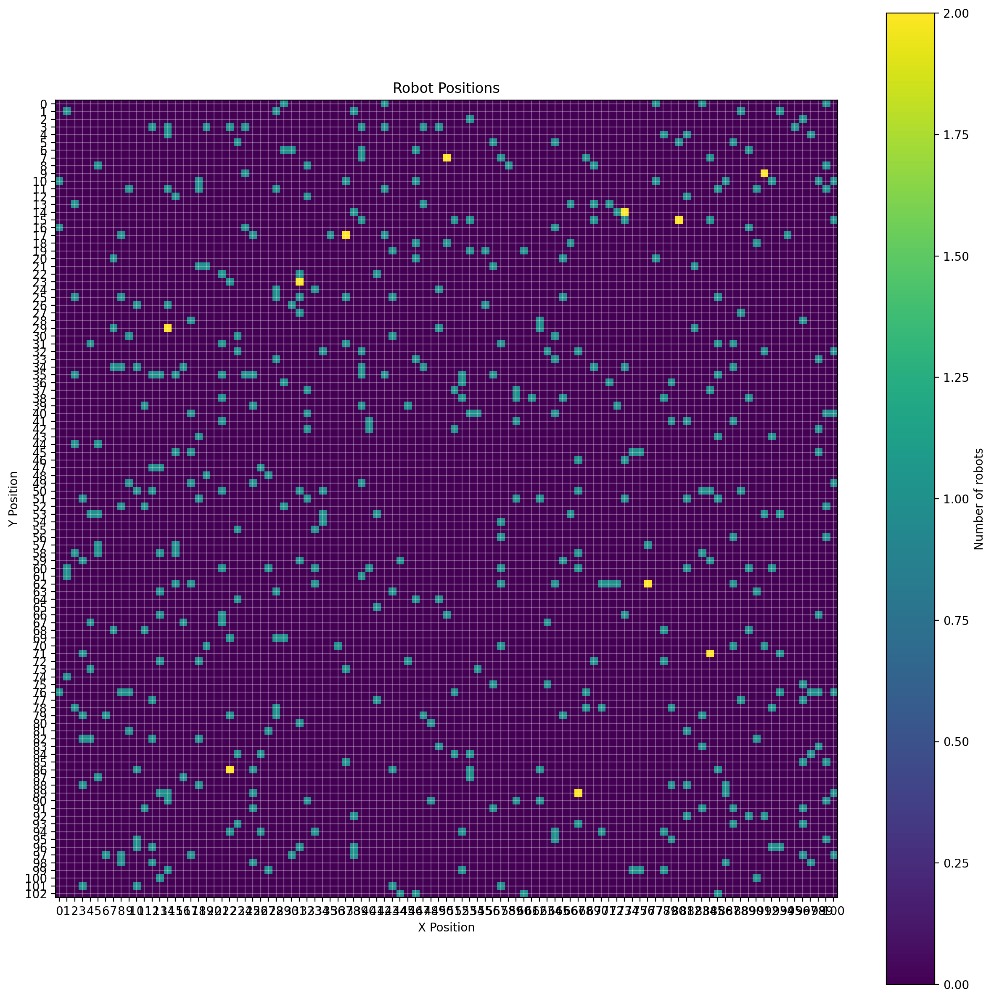

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_robots(finalp, grid_x, grid_y):
    plt.figure(figsize=(15, 15))
    
    # Create empty grid
    grid = np.zeros((grid_y, grid_x))
    
    # Fill grid with robot counts
    for (x, y), count in finalp.items():
        grid[y, x] = count
    
    # Plot with heatmap
    plt.imshow(grid, cmap='viridis', interpolation='nearest')
    plt.colorbar(label='Number of robots')
    
    # Add grid lines
    plt.grid(True, which='major', color='white', linestyle='-', alpha=0.3)
    plt.xticks(range(grid_x))
    plt.yticks(range(grid_y))
    
    plt.title(f'Robot Positions')
    plt.xlabel('X Position')
    plt.ylabel('Y Position')
    
    plt.show()

visualize_robots(finalp, grid_x, grid_y)

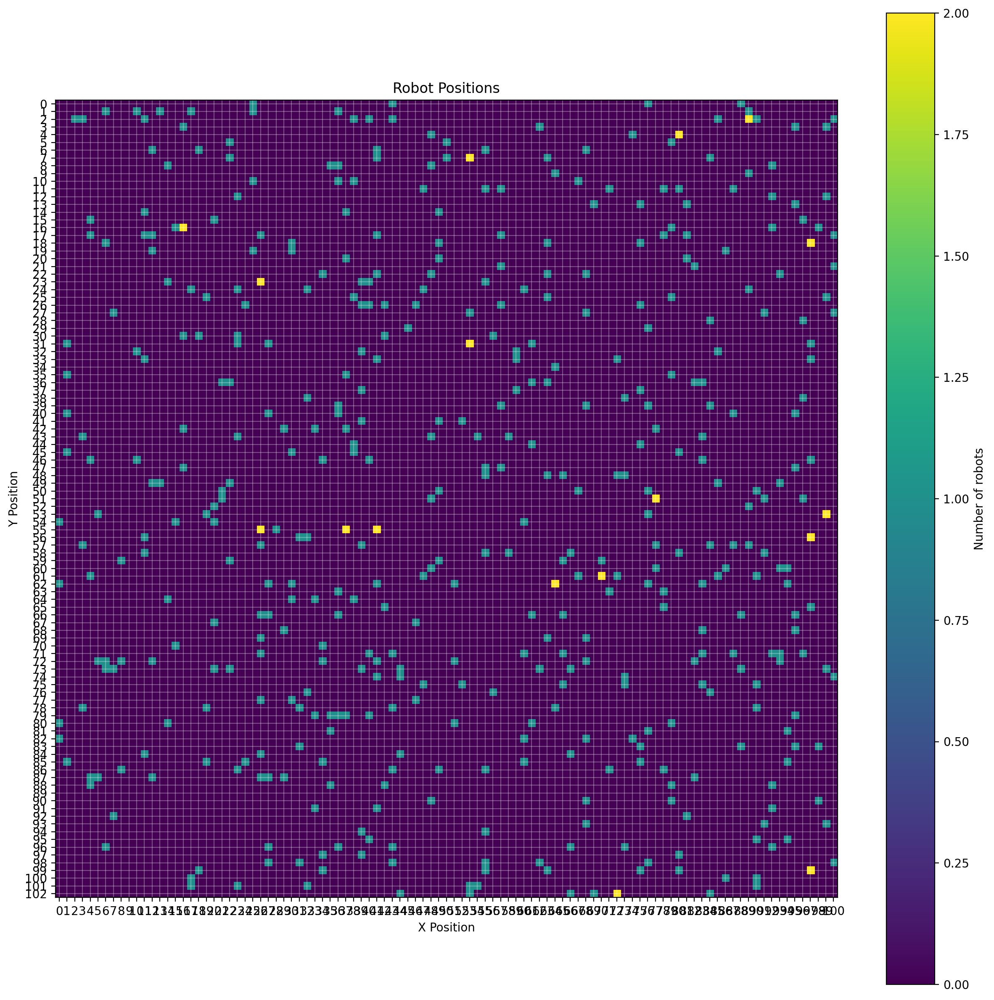

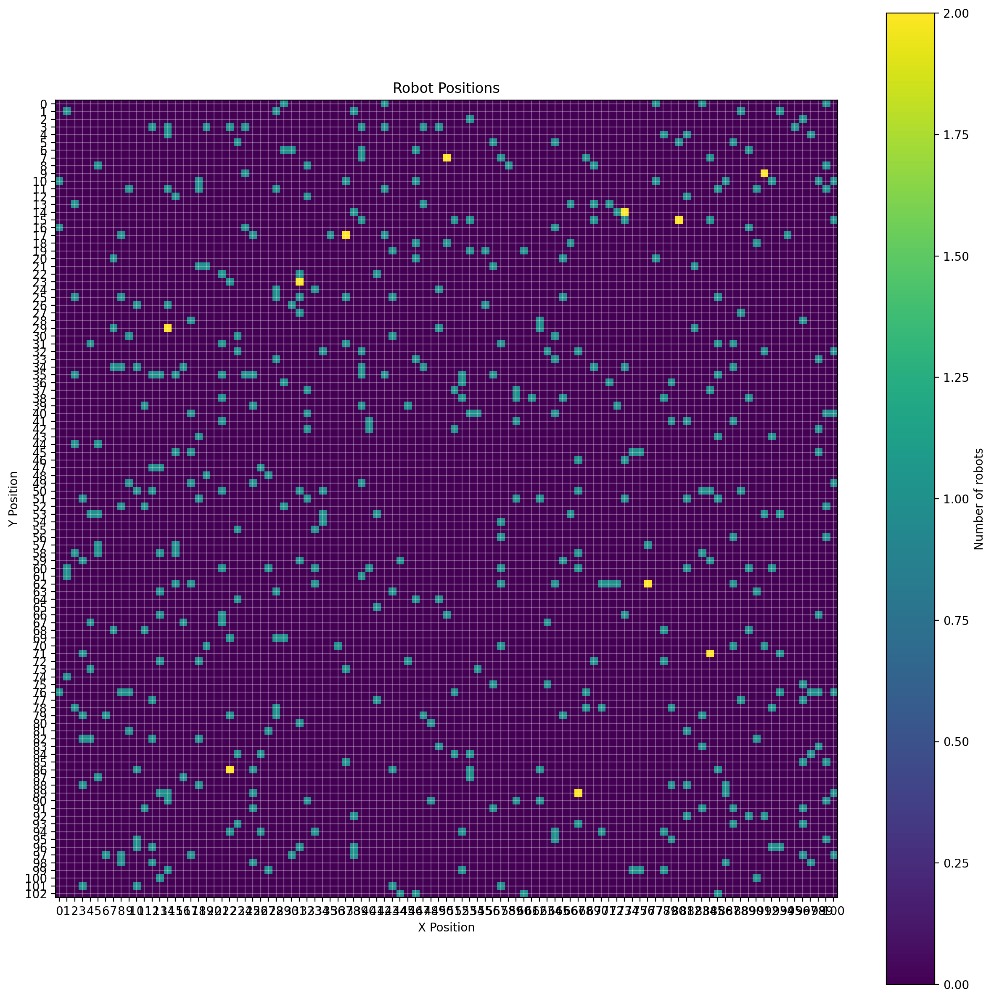

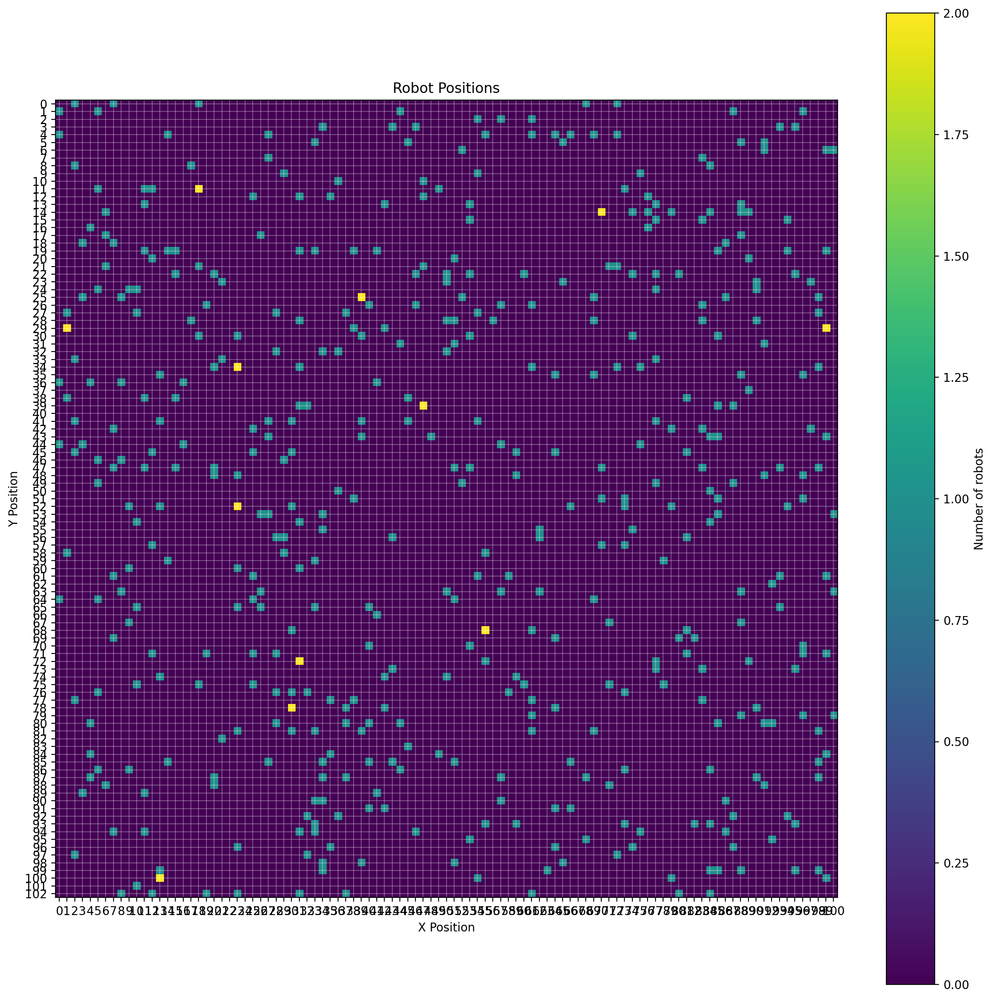

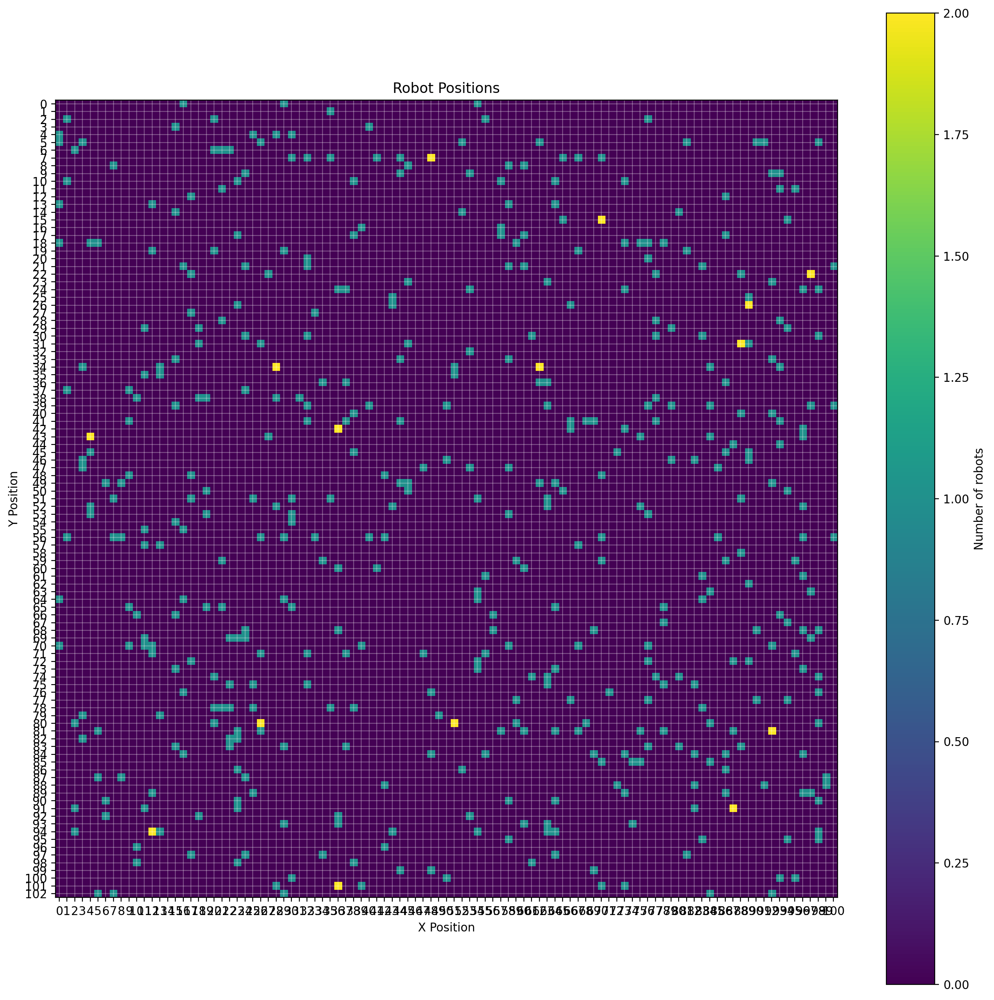

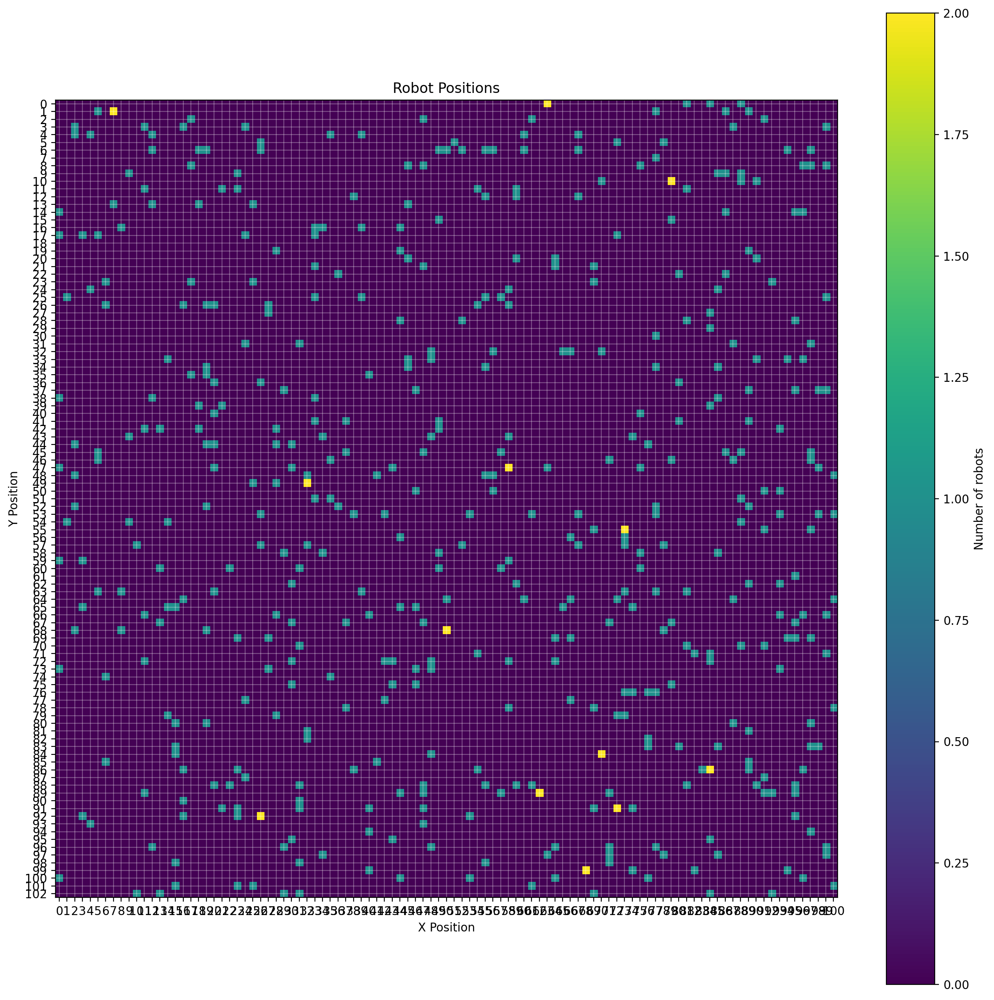

...

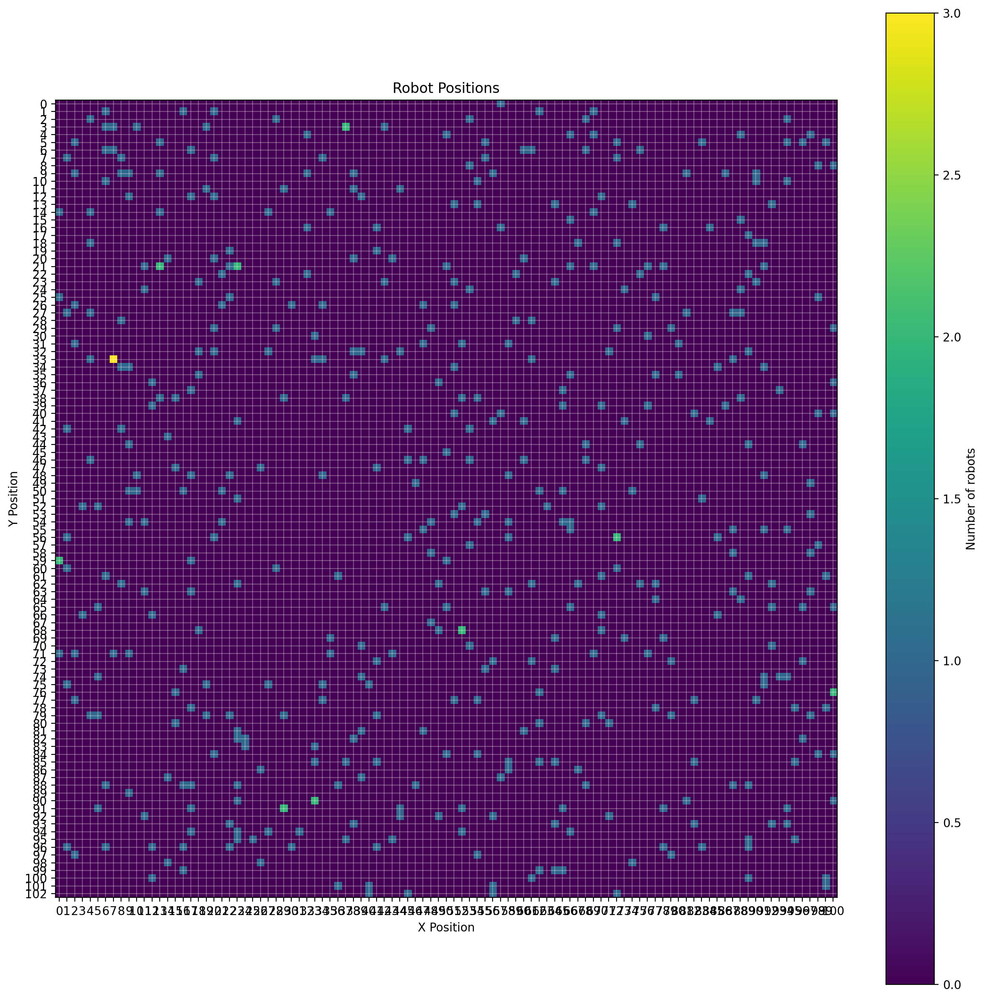

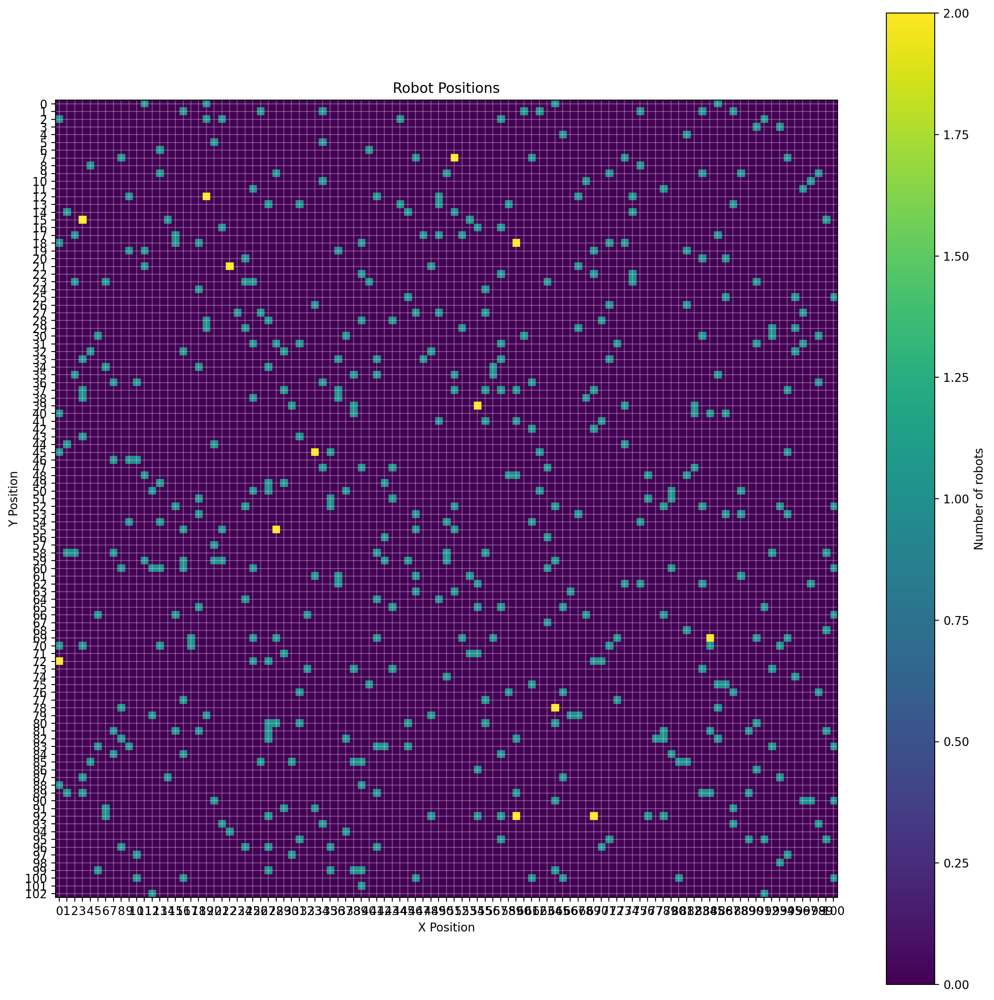

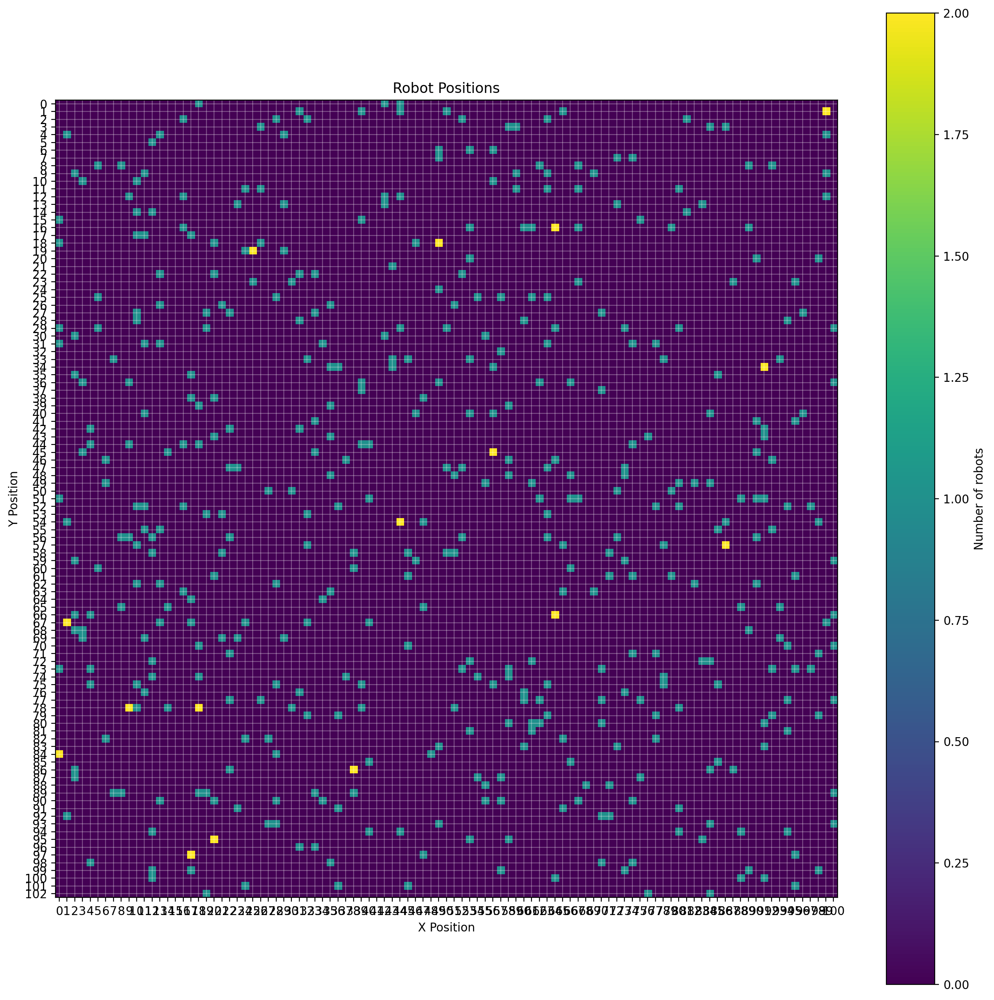

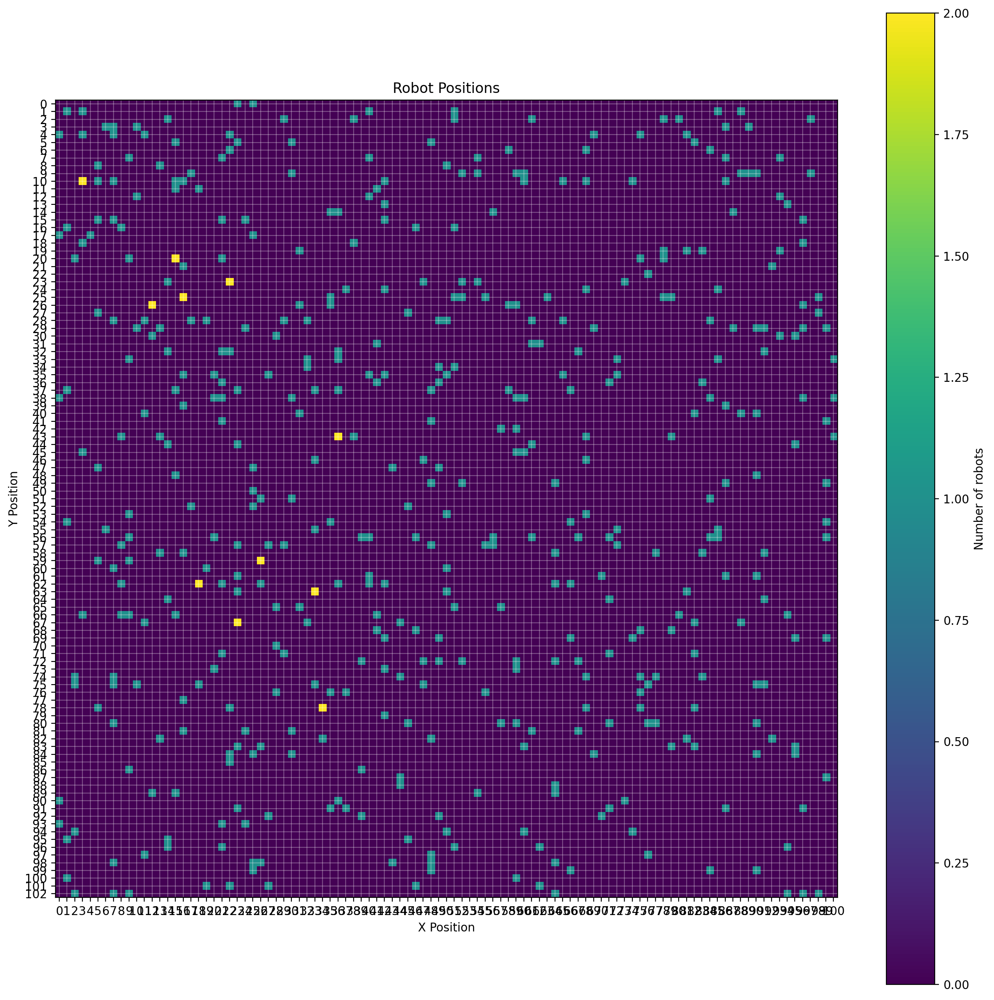

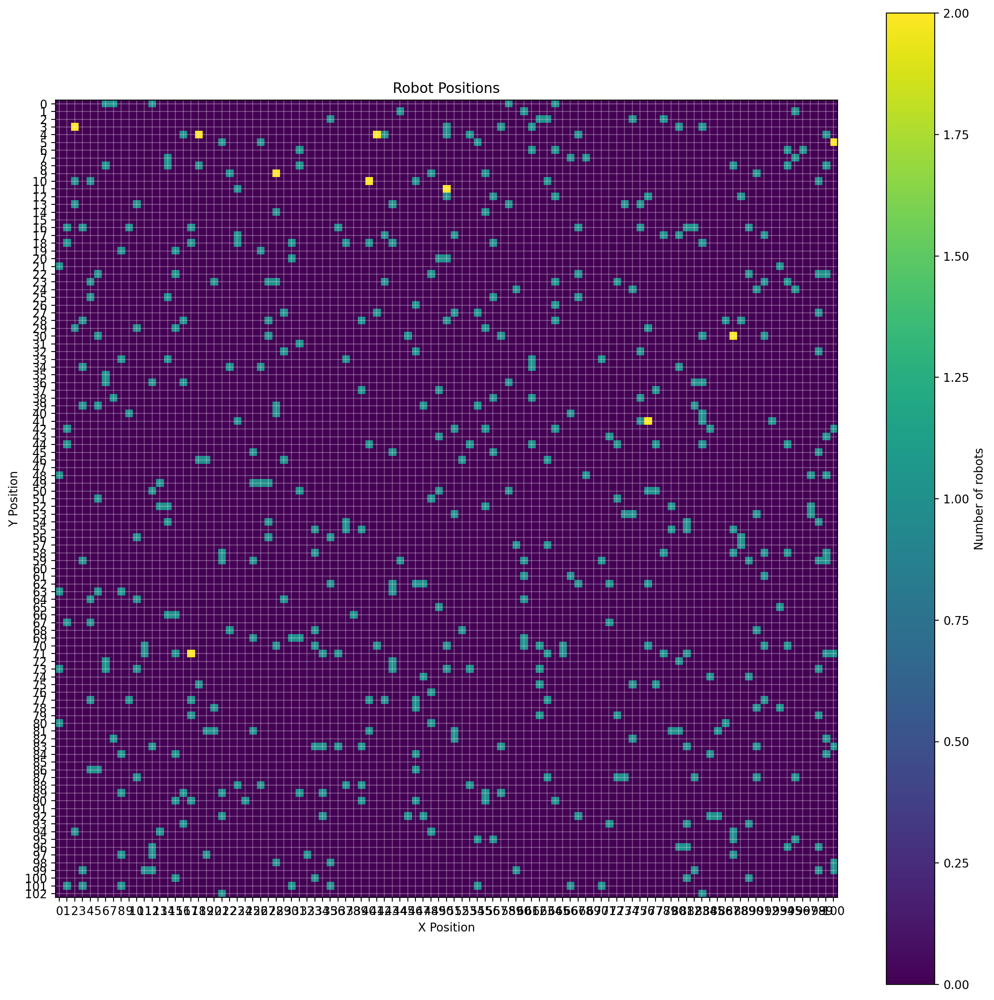

In [ ]:
rs, rv = parse_input(aoc_input)
grid_x = aoc_grid_x
grid_y = aoc_grid_y
seconds = 100

# lets visualize every 20 seconds
for secs in range(0, 5001, 100):
    finalp = get_final_positions(grid_x, grid_y, secs)
    visualize_robots(finalp, grid_x, grid_y)

#sf = get_safety_factor(finalp, grid_x, grid_y)
#print("safety factor=", sf)

**AI Prompt**

hmm i dont see any discernible pattern here

**AI Response**

Looking at the visualizations, you're right - there's no obvious Christmas tree pattern emerging in these time steps. We might need to:

1. Try different time intervals (maybe smaller steps between visualizations)
2. Look for other types of patterns besides the tree shape
3. Consider if there's a mathematical relationship we can use to predict when robots will align

Would you like to try visualizing with smaller time steps, or should we try a different approach to find the pattern? Perhaps we could:
- Look at the periods of individual robot movements
- Check for times when multiple robots converge
- Analyze the velocities to find common patterns

What approach would you like to explore?

**AI Prompt**

ok show me how to run this with an example

**AI Response**

Let's try running the animation with the sample data first, using a shorter time period to test:

```python
# First make sure we have sample data loaded
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y

# Run animation for 20 seconds with steps of 1 second
animate_robots(grid_x, grid_y, max_seconds=20, step=1)
```

This will show an animation running from 0 to 20 seconds, updating every second. If this works well, we can then:
1. Try it with longer time periods
2. Adjust the step size
3. Try it with the full puzzle input

Would you like to try this sample first?

In [ ]:
import matplotlib.animation as animation

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    def update(frame):
        ax.clear()
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_xticks(range(0, grid_x, 5))
        ax.set_yticks(range(0, grid_y, 5))
        ax.set_title(f'Time: {frame} seconds')
        return [im]
    
    ani = animation.FuncAnimation(fig, update, frames=range(0, max_seconds, step), 
                                interval=100, blit=True)
    plt.show()

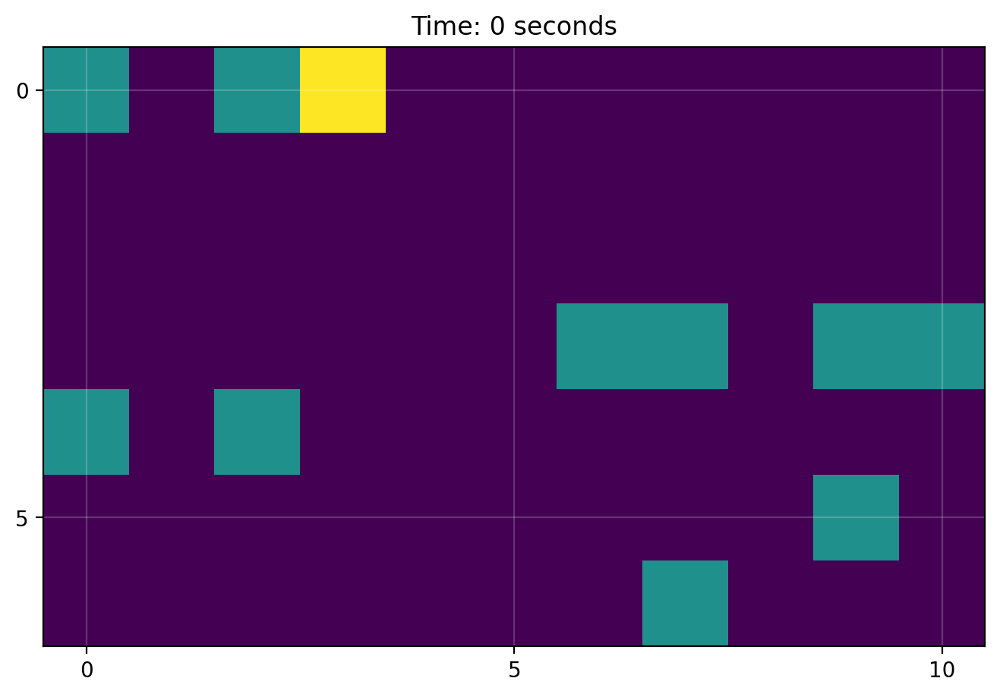

In [ ]:
# First make sure we have sample data loaded
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y

# Run animation for 20 seconds with steps of 1 second
animate_robots(grid_x, grid_y, max_seconds=20, step=1)

**AI Prompt**

it does not seem to be running ... how to get this to work ?

**AI Response**

Let's modify the animation code slightly to ensure it works. Here's a revised version with some debug printing and a few adjustments:

```python
import matplotlib.animation as animation

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    # Create initial grid
    grid = np.zeros((grid_y, grid_x))
    im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
    plt.colorbar(im)
    
    def update(frame):
        print(f"Processing frame {frame}")  # Debug print
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im.set_array(grid)
        ax.set_title(f'Time: {frame} seconds')
        return [im]
    
    ani = animation.FuncAnimation(fig, update, 
                                frames=range(0, max_seconds, step), 
                                interval=200,  # Slower animation
                                repeat=True)
    plt.show()
```

Let's try running it with a smaller range first:
```python
# Try with just 5 seconds to test
animate_robots(grid_x, grid_y, max_seconds=5, step=1)
```

This version should:
1. Print debug info so we can see if it's running
2. Use a slower animation speed
3. Keep the axes constant instead of clearing them

Would you like to try this version?

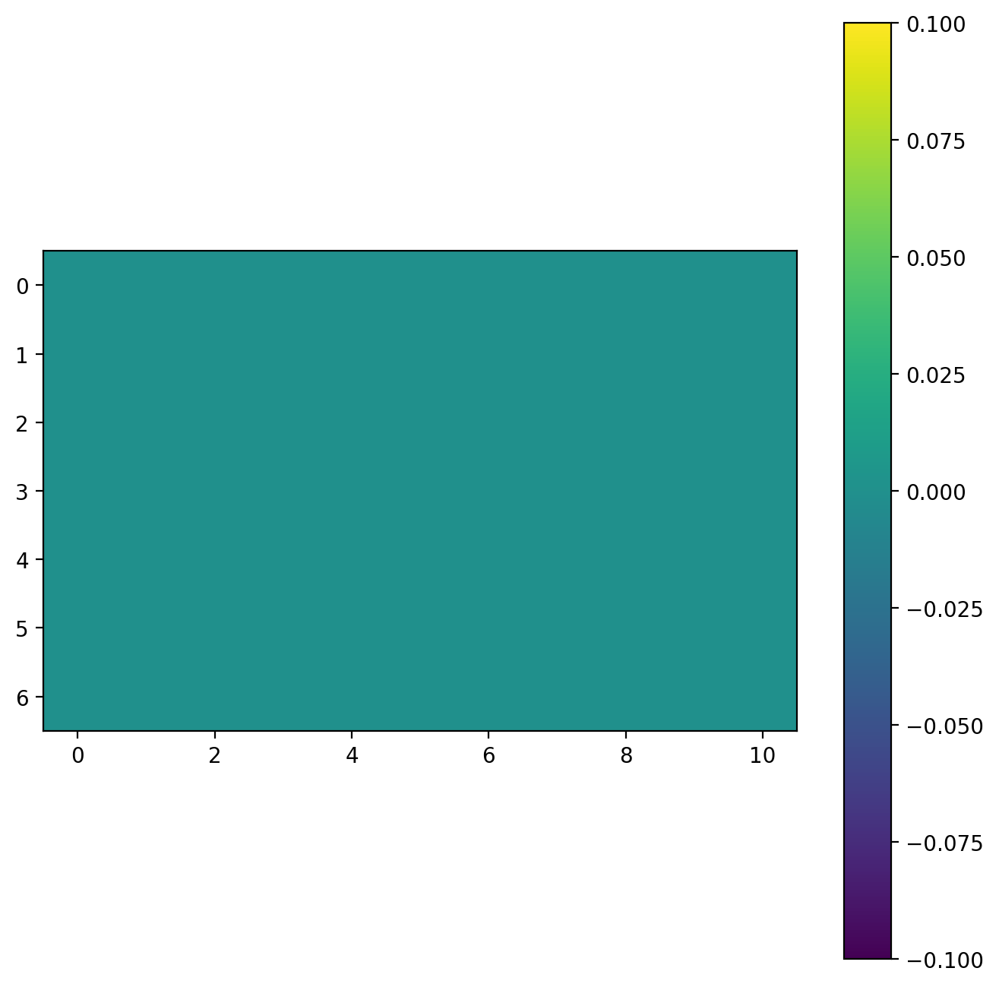

In [ ]:
import matplotlib.animation as animation

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    # Create initial grid
    grid = np.zeros((grid_y, grid_x))
    im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
    plt.colorbar(im)
    
    def update(frame):
        print(f"Processing frame {frame}")  # Debug print
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im.set_array(grid)
        ax.set_title(f'Time: {frame} seconds')
        return [im]
    
    ani = animation.FuncAnimation(fig, update, 
                                frames=range(0, max_seconds, step), 
                                interval=200,  # Slower animation
                                repeat=True)
    plt.show()

# Try with just 5 seconds to test
animate_robots(grid_x, grid_y, max_seconds=5, step=1)

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    ims = []
    for frame in range(0, max_seconds, step):
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest', animated=True)
        ims.append([im])
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_xticks(range(0, grid_x, 5))
        ax.set_yticks(range(0, grid_y, 5))
        ax.set_title(f'Time: {frame} seconds')

    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    plt.close() #Added this line to prevent a blank plot from appearing before animation
    return ani

# First make sure we have sample data loaded
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y

# Run animation for 20 seconds with steps of 1 second
ani = animate_robots(grid_x, grid_y, max_seconds=20, step=1)
HTML(ani.to_jshtml())

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    ims = []
    for frame in range(0, max_seconds, step):
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest', animated=True)
        ims.append([im])
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_xticks(range(0, grid_x, 5))
        ax.set_yticks(range(0, grid_y, 5))
        ax.set_title(f'Time: {frame} seconds')

    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    plt.close() #Added this line to prevent a blank plot from appearing before animation
    return ani

# First make sure we have sample data loaded
rs, rv = parse_input(sample_input)
grid_x = sample_grid_x
grid_y = sample_grid_y

# Run animation for 20 seconds with steps of 1 second
ani = animate_robots(grid_x, grid_y, max_seconds=20, step=1)
HTML(ani.to_jshtml())

In [ ]:
# prompt: can u show the # of seconds elapsed on the slider bar. And also how can we slow down the speed to half ?

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    ims = []
    for frame in range(0, max_seconds, step):
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest', animated=True)
        ims.append([im])
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_xticks(range(0, grid_x, 5))
        ax.set_yticks(range(0, grid_y, 5))
        ax.set_title(f'Time: {frame} seconds') # Display seconds on the title

    ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True, repeat_delay=1000) # Increased interval to slow down
    plt.close()
    return ani

In [ ]:
# First make sure we have sample data loaded
rs, rv = parse_input(aoc_input)
grid_x = aoc_grid_x
grid_y = aoc_grid_y

# Run animation for 20 seconds with steps of 1 second
ani = animate_robots(grid_x, grid_y, max_seconds=100, step=1)
HTML(ani.to_jshtml())

**AI Prompt**

hmm ok so the only pattern i note is about 10 seconds in we seem to get a horizontal column of robots on tiles formed (in the middle of the grid) and then about 10 seconds later, this same pattern happens vertically. is it possible, that we are basically flipping from horizontal to vertical for all frames after a certain time interval regularly

**AI Response**

I notice this appears to be a question about some kind of robot simulation or pattern analysis, but I don't have access to the visuals or data you're referring to. Could you:

1. Share more details about what you're observing?
2. Maybe share the code or visualization you're looking at?
3. Tell me what kind of problem you're trying to solve?

This will help me give you more relevant and specific guidance about the patterns you're noticing.

**AI Prompt**

can we update this code so that the animation slider shows us the interval value at the paused place. see code below: 
```
def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    ims = []
    for frame in range(0, max_seconds, step):
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest', animated=True)
        ims.append([im])
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_xticks(range(0, grid_x, 5))
        ax.set_yticks(range(0, grid_y, 5))
        ax.set_title(f'Time: {frame} seconds') # Display seconds on the title

    ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True, repeat_delay=1000) # Increased interval to slow down
    plt.close()
    return ani

# First make sure we have sample data loaded
rs, rv = parse_input(aoc_input)
grid_x = aoc_grid_x
grid_y = aoc_grid_y

# Run animation for 20 seconds with steps of 1 second
ani = animate_robots(grid_x, grid_y, max_seconds=100, step=1)
HTML(ani.to_jshtml())

```

**AI Response**

I notice you've shared some code that creates an animation of robot positions over time. Before I help modify it, could you clarify:

1. Are you looking to add a slider that shows the current time value when you pause the animation?
2. Would you like me to explain how to modify the code, or would you prefer I provide the complete solution?
3. Is this using Jupyter/IPython since I see the HTML() function being used?

This will help me provide the most appropriate assistance for your needs.

**AI Prompt**

yes exactly i'd like add a slider that shows the current time value when you pause the animation

**AI Response**

To add an interactive slider, we'll need to modify the code to use `FuncAnimation` instead of `ArtistAnimation`, and add widgets. Would you like me to:

1. Explain the steps we need to take to implement this change, or
2. Provide the complete modified code?

Also, just to confirm - do you want the slider to both show the current time AND allow you to manually control the animation by dragging it?

**AI Prompt**

yes slider to both show the current time AND allow you to manually control the animation by dragging it?. and also please provide complete modified code

**AI Response**

Here's the modified code that adds an interactive slider. You'll need to add `from ipywidgets import interact` at the top of your imports.

```python
from ipywidgets import interact
import matplotlib.animation as animation

def animate_robots(grid_x, grid_y, max_seconds, step=1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111)
    
    grid = np.zeros((grid_y, grid_x))
    im = ax.imshow(grid, cmap='viridis', interpolation='nearest', animated=True)
    ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
    ax.set_xticks(range(0, grid_x, 5))
    ax.set_yticks(range(0, grid_y, 5))
    
    def update(frame):
        finalp = get_final_positions(grid_x, grid_y, frame)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
        im.set_array(grid)
        ax.set_title(f'Time: {frame} seconds')
        return [im]
    
    ani = animation.FuncAnimation(fig, update, frames=range(0, max_seconds, step),
                                interval=100, blit=True, repeat_delay=1000)
    
    # Create interactive slider
    def animate_slider(frame):
        update(frame)
        plt.draw()
    
    interact(animate_slider, frame=(0, max_seconds-1, step))
    plt.close()
    return ani

# Run animation
ani = animate_robots(grid_x, grid_y, max_seconds=100, step=1)
HTML(ani.to_jshtml())
```

Try running this code. You should now see both the animation and a slider below it. You can:
1. Let the animation play automatically
2. Pause it and use the slider to move to specific times
3. See the current time both in the title and on the slider

Let me know if you need any adjustments or if something isn't working as expected!

**AI Prompt**

hmm ok so the only pattern i note is about 10 seconds in we seem to get a horizontal column of robots on tiles formed (in the middle of the grid) and then about 10 seconds later, this same pattern happens vertically. is it possible, that we are basically flipping from horizontal to vertical for all frames after a certain time interval regularly

**AI Response**

That's an interesting observation! To verify this pattern, we could:

1. Look at specific time intervals to check if there's a regular alternation
2. Maybe add a way to see multiple frames side by side

Would you like me to help you modify the code to:
a) Show frames at specific intervals (like t=10, t=20, t=30...) side by side, or
b) Add a way to track the pattern changes more precisely?

Which approach would you prefer to investigate this pattern?

**AI Prompt**

yeah lets try 2. write me some code to do that easily

**AI Response**

Here's code to create a grid of frames at specific time intervals so we can compare them side by side:

```python
def compare_frames(grid_x, grid_y, times_to_compare):
    """
    Display multiple frames side by side
    times_to_compare: list of time values to compare
    """
    n_frames = len(times_to_compare)
    fig, axes = plt.subplots(2, (n_frames+1)//2, figsize=(15, 8))
    axes = axes.flatten()
    
    for ax, t in zip(axes, times_to_compare):
        finalp = get_final_positions(grid_x, grid_y, t)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_title(f'Time: {t} seconds')
    
    plt.tight_layout()
    plt.show()

# Let's look at frames every 10 seconds from 0 to 50
compare_frames(grid_x, grid_y, [0, 10, 20, 30, 40, 50])
```

This will show 6 frames side by side. Let me know if you'd like to look at different time intervals or if you want to modify the visualization in any way!

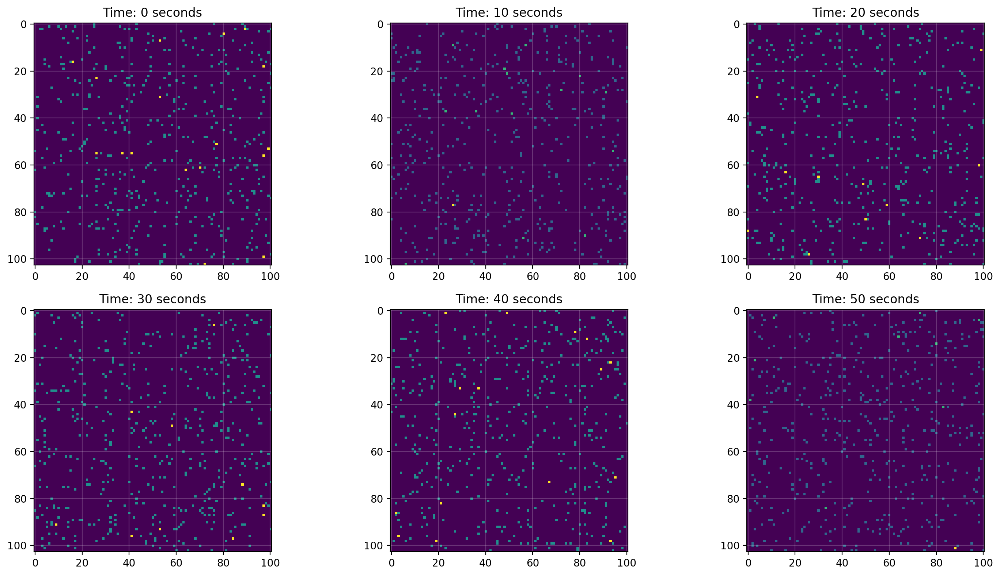

In [ ]:
def compare_frames(grid_x, grid_y, times_to_compare):
    """
    Display multiple frames side by side
    times_to_compare: list of time values to compare
    """
    n_frames = len(times_to_compare)
    fig, axes = plt.subplots(2, (n_frames+1)//2, figsize=(15, 8))
    axes = axes.flatten()
    
    for ax, t in zip(axes, times_to_compare):
        finalp = get_final_positions(grid_x, grid_y, t)
        grid = np.zeros((grid_y, grid_x))
        for (x, y), count in finalp.items():
            grid[y, x] = count
            
        im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
        ax.grid(True, which='major', color='white', linestyle='-', alpha=0.2)
        ax.set_title(f'Time: {t} seconds')
    
    plt.tight_layout()
    plt.show()

# Let's look at frames every 10 seconds from 0 to 50
compare_frames(grid_x, grid_y, [0, 10, 20, 30, 40, 50])

**AI Prompt**

ok i am stumped ... what are ways to detect a christmas tree pattern in this problem ...

**AI Response**

Looking at your question about detecting a Christmas tree pattern, let me ask a few clarifying questions:

1. Are you looking for a literal Christmas tree shape in the robot positions, or is this part of a larger puzzle where "Christmas tree" might have a specific meaning?

2. From the frames we're seeing, I don't immediately spot a Christmas tree shape - could you point out what makes you think there might be one, or share what pattern you're trying to identify?

3. Would it help to look at different time intervals, or perhaps visualize the data in a different way?

Let me know which direction you'd like to explore and I can help you investigate further!

**AI Prompt**

ok at frame 12 and frame 35 can u show the visual there ?

**AI Response**

I'll modify the previous code to show those specific frames:

```python
# Let's look at frames 12 and 35
compare_frames(grid_x, grid_y, [12, 35])
```

This will show us those two specific timestamps side by side. Once you see these frames, could you point out what patterns you notice? This might help us understand what we're looking for.

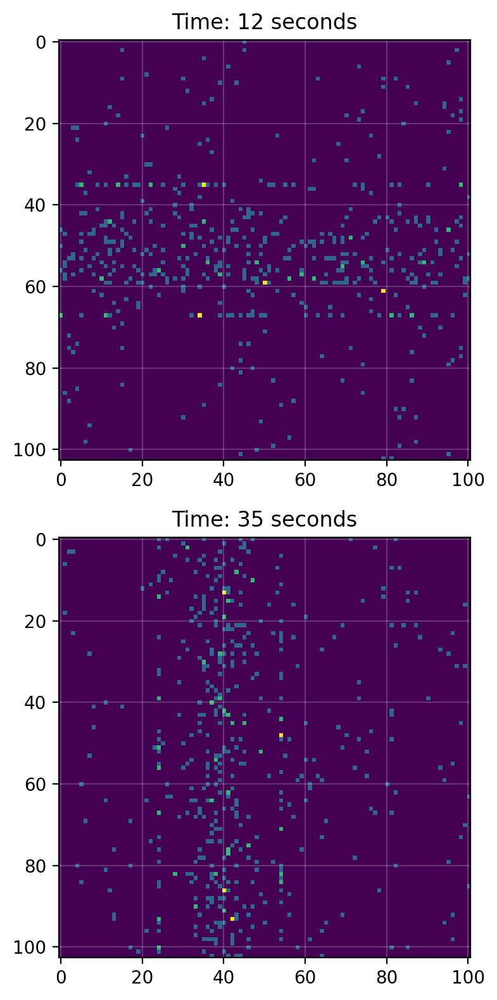

In [ ]:
compare_frames(grid_x, grid_y, [12, 35])

**AI Prompt**

what do u think of this pattern ?

**AI Response**

Ah, now I see something interesting! At frame 12, there appears to be a more horizontal concentration of robots (like a horizontal line or band), while at frame 35, the robots have formed more of a vertical concentration (like a vertical column) roughly in the middle of the grid.

This could be significant. Would you like to:
1. Look at a few frames between these two to see how the pattern transitions?
2. Check if this horizontal-to-vertical pattern repeats at similar intervals?
3. Analyze the density of robots in these concentrated areas?

Which aspect would be most helpful to investigate?